# ATS at the NGEE Arctic ModEx Workshop

This notebook will be the presentation method of choice for this workshop.

Please open this notebook in the **visualization** container.

Please also open a terminal in the **modeling** container.

In the **modeling** container terminal, you'll need to do some setup.  Run the script:

```
. /home/modex_user/model_examples/ATS/setup_ats.sh
```

Note that this will move you into the directory `/mnt/output/ATS`, which is where all of our demos will be run from.  It also sets an environment variable pointing to this location:

```
echo $ATS_DEMOS
```

In [1]:
import sys,os
sys.path.append("/home/jovyan/model_examples/ATS/tools")

import ats_xdmf
import plot_column_data
import plot_wrm
import colors
from itertools import islice
import numpy as np
import matplotlib.cm
from matplotlib import pyplot as plt
from IPython.display import HTML


figsize = (10,5)

In [13]:
def plotTime(testname, axs, style, time_index=-1):
    """A generic plotting function that plots saturation as a function of depth."""
    directory = f"/mnt/output/ATS/{testname}"
    
    # load the data
    vis = ats_xdmf.VisFile(directory, output_time_unit='d')
    vis.loadMesh(columnar=True)

    dati = np.array([vis.getArray(v) for v in ["pressure", "saturation_liquid", 
                                    "saturation_ice", "saturation_gas", "temperature"]])

    # plot saturation of liquid, pressure
    z = vis.centroids[:,2]
    axs[0].plot(dati[3,time_index,:],z, style, color='r', label='gas')
    axs[0].plot(dati[2,time_index,:],z, style, color='c', label='ice')
    axs[0].plot(dati[1,time_index,:],z, style, color='b', label='liquid')
    axs[1].plot(dati[0,time_index,:],z, style, color='k')
    axs[2].plot(dati[4,time_index,:],z, style, color='k')
    

def decorate(axs):
    axs[0].set_xlabel('saturation [-]')
    axs[0].set_ylabel('z-coordinate [m]')
    axs[0].set_xlim([-.1,1.1])
    axs[0].legend()
    i = 1
    
    if len(axs) == 3:
        axs[i].set_xlabel('pressure [Pa]')
        axs[i].ticklabel_format(style='sci', axis='x', scilimits=(0,0))
        i = 2
    
    axs[i].set_xlabel('temperature [K]')
    axs[i].set_xlim([250,280])


import matplotlib.animation as animation

def plotAnimation(testname, fig, axs_all, style, save_filename=None, fps=5):
    directory = f"/mnt/output/ATS/{testname}"
    
    # load the data
    vis = ats_xdmf.VisFile(directory, output_time_unit='d')
    vis.loadMesh(columnar=True)     
    dati = np.array([vis.getArray(v) for v in ["pressure", "pressure", "saturation_liquid", 
                                    "saturation_ice", "saturation_gas", "temperature"]])
    times = vis.times

    # load the surface data
    vis_surf = ats_xdmf.VisFile(directory, 'surface', output_time_unit='d')
    datsurfi = np.array([vis_surf.getArray(v) for v in ['surface-temperature', 'surface-ponded_depth', 'snow-depth']])
    
    ice = colors.cm_mapper(-10, times[-1], colors.ice_cmap())
    water = colors.cm_mapper(-10, times[-1], colors.water_cmap())
    gas = colors.cm_mapper(-10, times[-1], colors.gas_cmap())    
    
    z = vis.centroids[:,2]

    # plot surface
    axs_surf = axs_all[0]
    axs_surf[0].plot(times, datsurfi[1][:,0], 'b', label='water')
    axs_surf[0].plot(times, datsurfi[2][:,0], 'c', label='snow')
    axs_surf[0].legend()
    axs_surf[0].set_xlabel('time [d]')
    axs_surf[0].set_ylabel('depth [m]')
    axs_surf[1].plot(times, datsurfi[0][:,0], 'r') 
    axs_surf[1].set_xlabel('time [d]')
    axs_surf[1].set_ylabel('temperature [K]')
    
    # Add tracking circles for surface plots
    circle_ponded = axs_surf[0].plot([], [], 'bo', markersize=10, markerfacecolor='none', markeredgewidth=2)[0]
    circle_snow = axs_surf[0].plot([], [], 'co', markersize=10, markerfacecolor='none', markeredgewidth=2)[0]
    circle_temp = axs_surf[1].plot([], [], 'ro', markersize=10, markerfacecolor='none', markeredgewidth=2)[0]
    
    # plot subsurface -- Initialize empty line objects
    axs = axs_all[1]
    lines = []
    lines = [axs[0].plot([], [], style, color='b')[0],
             axs[0].plot([], [], style, color='c')[0],
             axs[0].plot([], [], style, color='r')[0],
             axs[1].plot([], [], style, color='k')[0],
            ]

    # also plot a T = 0 line
    axs[1].plot([273.15,273.15], [-50, 50], 'k--')
    axs[1].set_xlabel('z-coordinate [m]')
    
    # Add title to first axis
    time_text = axs[1].text(0.5, 0.95, '', 
                            verticalalignment='top', horizontalalignment='center',
                            bbox=dict(boxstyle='round'))
    
    def init():
        """Initialize animation"""
        for line in lines:
            line.set_data([], [])
        time_text.set_text('')

        circle_ponded.set_data([], [])
        circle_snow.set_data([], [])
        circle_temp.set_data([], [])
        return lines + [time_text]
    
    def animate(i):
        """Update animation for frame i"""
        t = times[i]
        
        # Update saturation plot (axs[0])
        lines[0].set_data(dati[2,i,:], z)  # liquid
        lines[1].set_data(dati[3,i,:], z)  # ice
        lines[2].set_data(dati[4,i,:], z)  # gas
        
        # Update pressure plot (axs[1])
        #lines[3].set_data(dati[1,i,:], z)
        
        # Update temperature plot (axs[2])
        lines[3].set_data(dati[5,i,:], z)

        # Update tracking circles on surface plots
        circle_ponded.set_data([t], [datsurfi[1][i,0]])
        circle_snow.set_data([t], [datsurfi[2][i,0]])
        circle_temp.set_data([t], [datsurfi[0][i,0]])
        
        # Update time text
        time_text.set_text(f'Time: {t:.2f} days')
        
        return lines + [time_text]
    
    # Create animation
    anim = animation.FuncAnimation(axs[0].figure, animate, init_func=init,
                                   frames=len(times), interval=1000/fps, 
                                   blit=True, repeat=True)
    
    # Add legend to first axis
    axs[0].plot([], [], style, color=water(times[-1]), label='liquid')
    axs[0].plot([], [], style, color=ice(times[-1]), label='ice')
    axs[0].plot([], [], style, color=gas(times[-1]), label='gas')
    axs[0].legend()

    # set axis labels, etc
    decorate(axs)
    axs[0].set_ylim([4,5])
    axs[1].set_ylim([-10,5])
    
    
    # Return HTML for Jupyter display
    return HTML(anim.to_jshtml())            

## Conceptual Model

We will work largely on a vertical column model for this workshop, just to make it simpler to compare with ELM.

In this column, we will use a "telescoping" grid that starts with small dz = 2cm at the surface and grows to dz = 2 meters at "depth," which is chosen to be below continuous permafrost and deep enough to be below the thermal wave (e.g. at constant temperature over decadal-to-century timescales). 


## Demo 1: Establish a water table

First we simply establish a "hydrostatic" condition -- a column of water that is not moving.

$p = p_{atm} - \rho g (z - z_{water})$

This is the simplest thing to do in an ATS run, but will let us ensure we can run ATS and visualize the output.

### Run the model

In the **modeling** container's bash shell:

```
cd $ATS_DEMOS/01_water_column
ats ../input/01_water_column.xml &> out.log
```

### Think about the result
<details>
  <summary>What do you expect to see?</summary>

* linear solution of pressure with depth (hydrostatic)
* a water table (saturation = 1) below, a vadose zone (saturation < 1) above

### Look at the log file

Explore the output.

```
less out.log
```

Some notes:
* We start with a solution that is very close to hydrostatic already (it would be except for the compressibility of water), so the error is initially effectively 0.
* The timestep grows quickly from the initial step size to very large timesteps.
* ATS is tracking the conservation of mass and energy -- eventually the step becomes large enough so that the error is greater than tolerance, and then the solver starts to do work.

### Plot the result

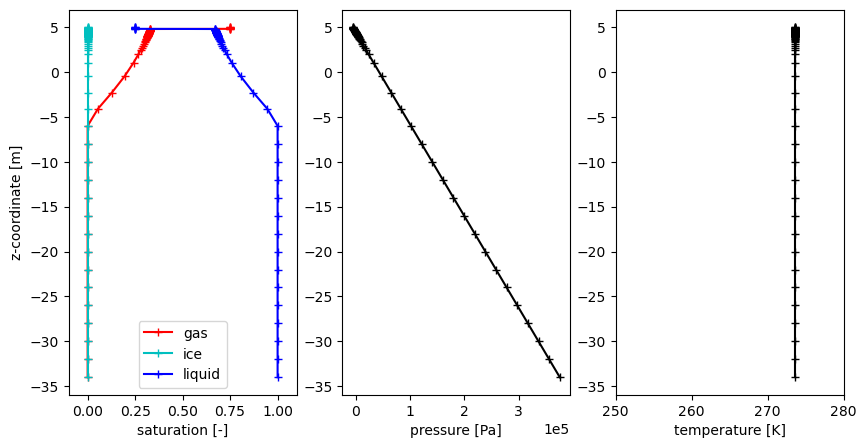

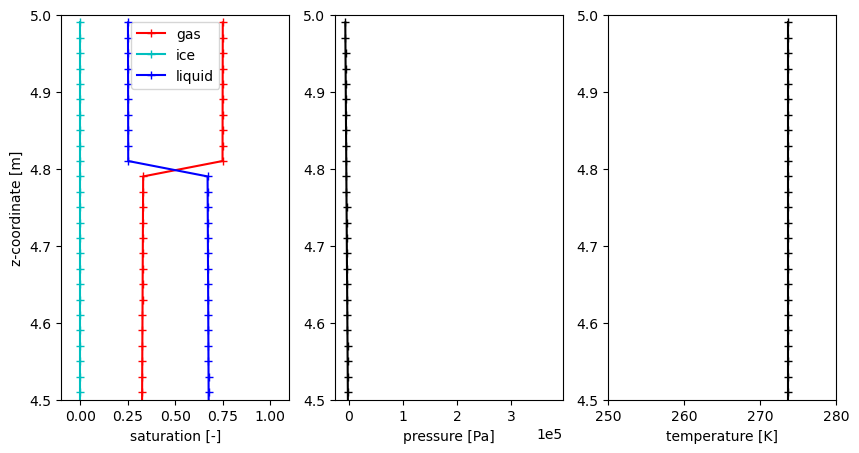

In [3]:
# full column
fig, axs = plt.subplots(1,3, figsize=figsize)
plotTime('00_water_column', axs, '-+', -1)
decorate(axs)

# and a zoomed version that shows the very shallow subsurface
fig, axs = plt.subplots(1,3, figsize=figsize)
plotTime('00_water_column', axs, '-+', -1)
decorate(axs)
axs[0].set_ylim([4.5,5])
axs[1].set_ylim([4.5,5])
axs[2].set_ylim([4.5,5])
plt.show()

### Think about the result

<details>
  <summary>Why is the saturation discontinuous?</summary>

ATS makes extensive use of heterogeneous soil properties.  Arctic models typically require at least an organic-rich peat and a mineral soil.  In this demo, we will use a domain with $20~cm$ of peat on top of the mineral soil.

These have very different porosity, permeability, and water retention properties: let's compare peat mineral soil.

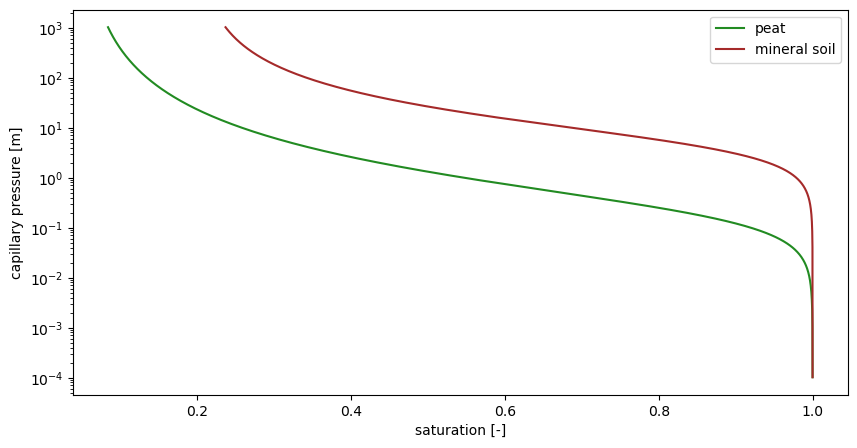

In [4]:
fig, ax = plt.subplots(1,1, figsize=figsize)

# peat
vg_peat = plot_wrm.VanGenuchten(alpha=0.0005, n=1.39, sr=0.05)
plot_wrm.plot(vg_peat, ax, 'forestgreen', label='peat', y_units='m') 

# mineral soil
vg_min = plot_wrm.VanGenuchten(alpha=0.00002, n=1.58, sr=0.2)
plot_wrm.plot(vg_min, ax, 'brown', label='mineral soil', y_units='m') 
ax.legend()

plt.show()

## Demo 2: Freeze from below

Now we want to model permafrost -- how do we initialize a frozen water table?

Guess 1: set the temperature at depth < 0 (in this case T = -9 C) and freeze the column of water.

### Run the model

In the **modeling** container's bash shell:

```
cd $ATS_DEMOS/02_freezeup_from_below
ats ../input/02_freezeup_from_below.xml &> out.log
```

### Think about the result
<details>
  <summary>What do you expect to see?</summary>

* A "frozen" water table, with ice saturation = 1?  With gas saturation = 0?


### Plot the result

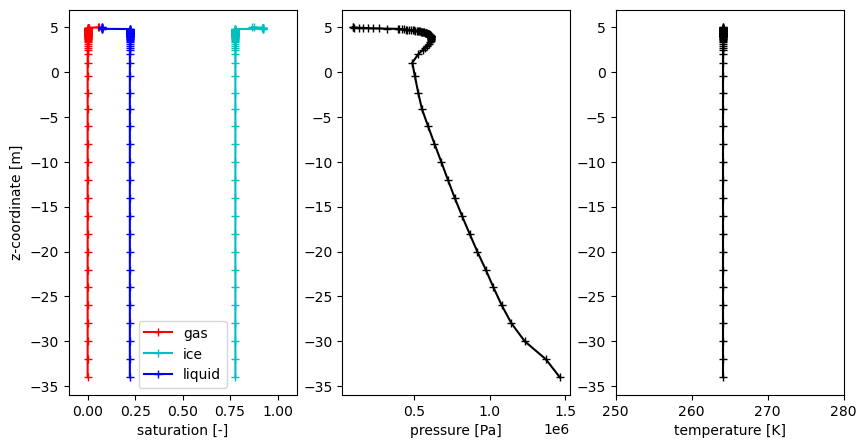

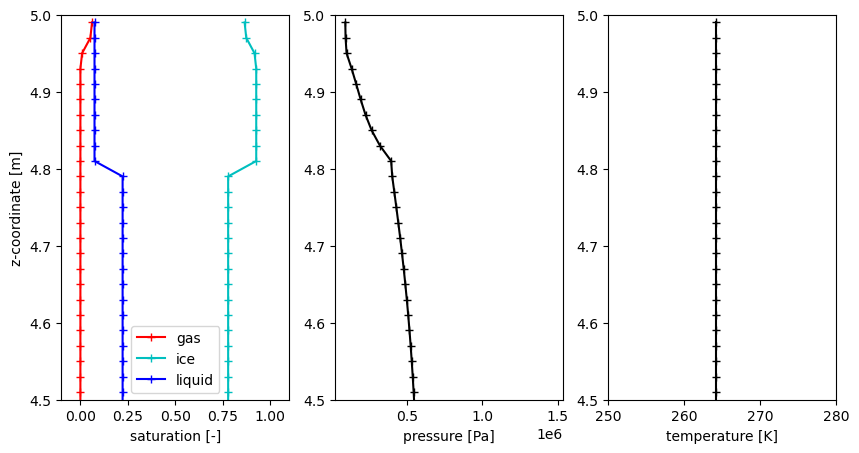

In [5]:
# full column
fig, axs = plt.subplots(1,3, figsize=figsize)
plotTime('02_freezeup_from_below', axs, '-+', -1)
decorate(axs)

# and a zoomed version that shows the very shallow subsurface
fig, axs = plt.subplots(1,3, figsize=figsize)
plotTime('02_freezeup_from_below', axs, '-+', -1)
decorate(axs)
axs[0].set_ylim([4.5,5])
axs[1].set_ylim([4.5,5])
axs[2].set_ylim([4.5,5])
plt.show()

### Think about the result

<details>
  <summary>Why is the ice table so much higher than the water table?</summary>

Ice is less dense than water.  While the total water (moles of $H_2O$) is conserved, the frozen ice table takes up more volume than the corresponding water table.




## Demo 3: Freeze from above

Why didn't we freeze from above?  Good question -- let's try it!

### Run the model

In the **modeling** container's bash shell:

```
cd $ATS_DEMOS/03_freezeup_from_above
ats ../input/03_freezeup_from_above.xml &> out.log
```

### Think about the result
<details>
  <summary>What do you expect to see?</summary>

* same as above?


### Plot the result

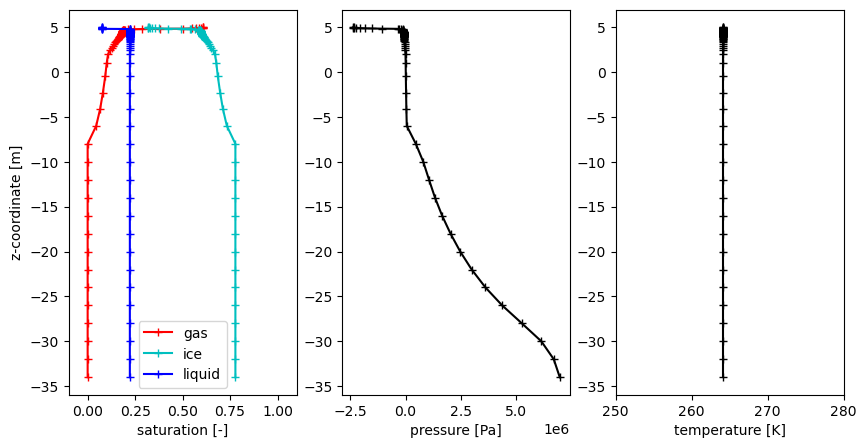

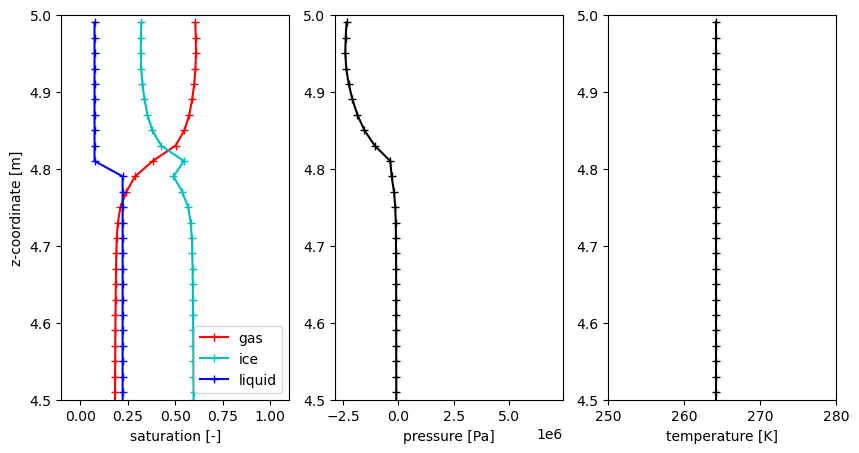

In [6]:
# full column
fig, axs = plt.subplots(1,3, figsize=figsize)
plotTime('03_freezeup_from_above', axs, '-+', -1)
decorate(axs)

# and a zoomed version that shows the very shallow subsurface
fig, axs = plt.subplots(1,3, figsize=figsize)
plotTime('03_freezeup_from_above', axs, '-+', -1)
decorate(axs)
axs[0].set_ylim([4.5,5])
axs[1].set_ylim([4.5,5])
axs[2].set_ylim([4.5,5])
plt.show()

### Think about the result

<details>
  <summary>Why is unsaturated zone so much deeper?</summary>

_Cryosuction_ In a freezing, unsaturated soil, the pressure drops, pulling nearby unfrozen water into the freezing front.

Comparison of lab experiments (dots) (Watanabe & Mizoguhi 2002 at left, Jame & Norum 1980 at right) to simulations (Painter 2011) shows that cryosuction can be accurately modeled in coupled flow & energy models, given the right constitutive models.

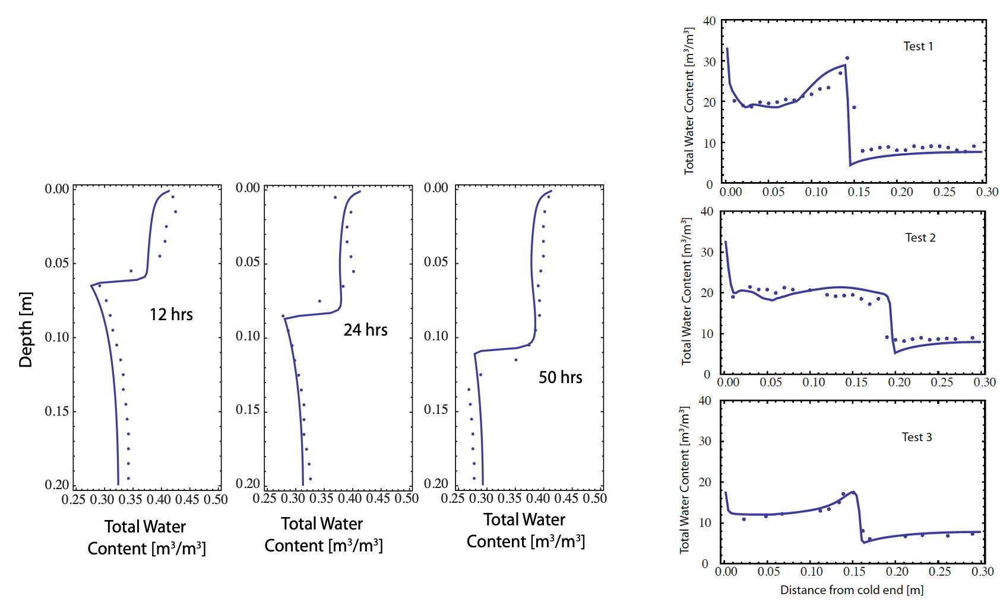

## Demo 4: Spin up the column

We now have a frozen ice table -- let's apply meteorological data and do a transient run.

The second step of spinup is to apply a "typical" or "averaged" meteorological forcing from a given climatology to get reasonable temperature profiles


In [7]:
# plot the met data

### Run the model

In the **modeling** container's bash shell:

```
cd $ATS_DEMOS/04_permafrost_column
ats ../input/04_permafrost_column.xml &> out.log
```

### Think about the result
<details>
  <summary>What do you expect to see?</summary>

* A thermal wave progating from the surface to the subsurface.
* An active layer thawing and freezing.

### Plot the result

In [11]:
# full column
fig, axs = plt.subplots(2,2, figsize=(figsize[0], figsize[1]*1.2))
html = plotAnimation('04_permafrost_column', fig, axs, '-', fps=10)
plt.close(axs[0,0].figure)
html

Animation size has reached 21012894 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


### Think about the result
<details>
  <summary>What do you expect to see?</summary>

* A thermal wave progating from the surface to the subsurface.
* An active layer thawing and freezing.

## Demo 5: Lateral, supra-permafrost flow

Columns are nice (and simple) but do not capture supra-permafrost lateral flow, which is the crucial pathway for water movement in sloped landscapes in Arctic watersheds.  When through taliks form, we expect fundamental changes in the flow pathways.

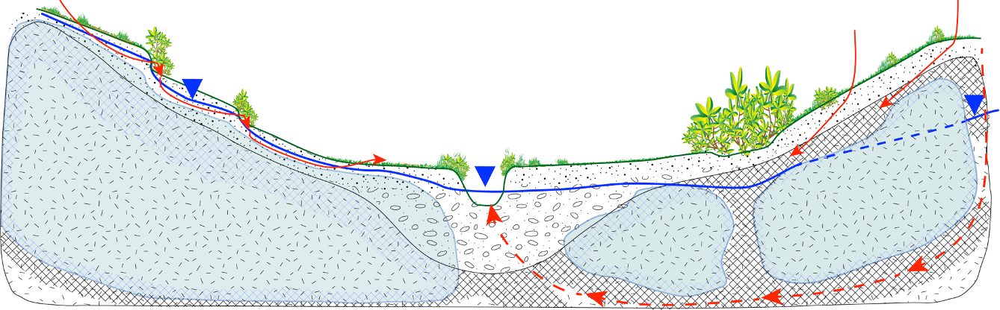
(courtesy Cathy Wilson)

As the Arctic warms, we expect flow pathways to get deeper, accessing the mineral soil (low porosity, permeability) more than the organic layer (high porosity, permeability).

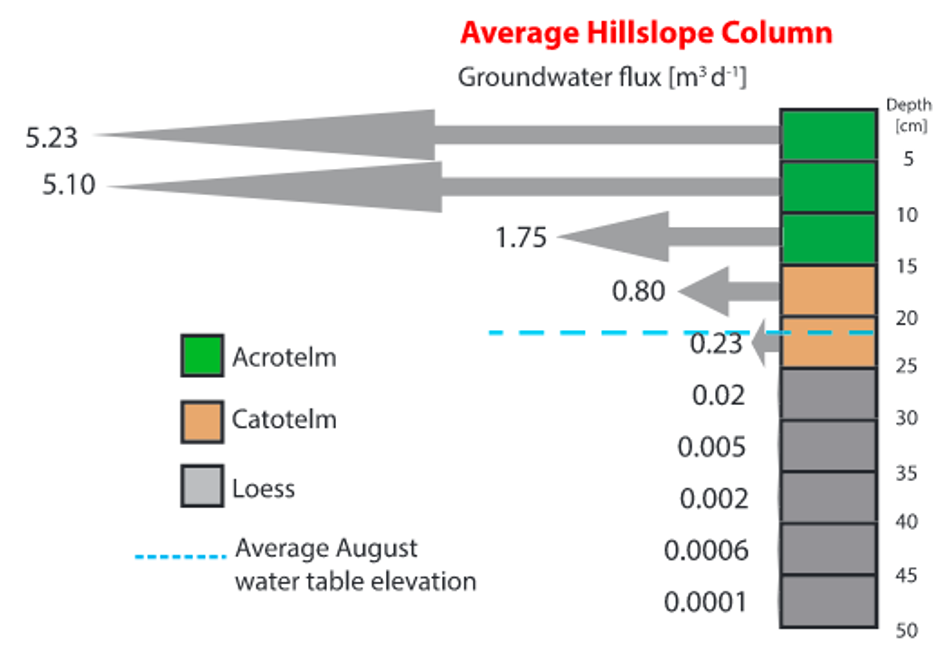
(O'Connor et al 2019)

### Run the model

In the **modeling** container's bash shell:

```
cd $ATS_DEMOS/05_permafrost_transect
ats ../input/05_permafrost_transect.xml &> out.log
```

### Think about the result
<details>
  <summary>What do you expect to see?</summary>

* ???